<a href="https://colab.research.google.com/github/HyunMooKim/Data-Analysis-Meaching-Learning/blob/main/Electricity_contest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ReadMe


 데이콘의 주식투자 알고리즘 대회에 참여하며 같이 열린 전력 예측대회에도 참여했다. 100개 건물의 전력 사용량 예측 대회이다. <br> https://dacon.io/competitions/official/236125/overview/description
<br>

<br>EDA로 데이터가 어떤 특성을 갖는지 살펴보고, 데이터 featuring으로 의미 있는 파생 변수들을 만들고 XGBOOST, CATBOOST, LGBM, Random Forest 등 다양한 기법을 이용하여 예측을 진행해 보았다.<br><br>


 낮을수록 좋은 SMAPE 점수 6.1점대로 우승자들의 점수인 4.8~5.1까지 낮추지는 못했지만, EDA부터 모델 구축 및 예측까지의 과정을 혼자 진행해 본 좋은 경험이었다.


# EDA

building_info를 보면, 건물 유형이 총 12개로 나뉜다.

1~15  건물기타

16~23 공공

24~31 대학교

32~36 데이터센터

37~44 백화점및아울렛

45~52 병원

53~60 상용

61~68 아파트

69~76 연구소

77~84 지식산업센터

85~92 할인마트

93~100 호텔및리조트

In [ ]:
import numpy as np
import pandas as pd

# EDA
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats
from scipy.stats import skew
from scipy.stats import spearmanr

import warnings
warnings.filterwarnings('ignore')

SEED = 2
np.random.seed(SEED)
#공휴일 여부 확인
def is_holiday(date, holiday_list):
    return 1 if (date in holiday_list) else 0
#토, 일, 공휴일
holidays = ['20220601', '20220606', '20220815', '20220604', '20220605',
 '20220611', '20220612', '20220618', '20220619',
 '20220625', '20220626', '20220702', '20220703',
 '20220709', '20220710', '20220716', '20220717',
 '20220723', '20220724', '20220730', '20220731',
 '20220806', '20220807', '20220813', '20220814',
 '20220820', '20220821', '20220827', '20220828']


In [ ]:
train_df = pd.read_csv('train.csv', encoding='cp949')
test_df = pd.read_csv('test.csv', encoding='cp949')
building_df = pd.read_csv('building_info.csv', encoding='cp949')


'''================= 데이터의 결측치 처리 ==================='''
#test 예측 시에 사용할 수 없는 일조, 일사 열 제거
train_df = train_df.drop(['일조(hr)','일사(MJ/m2)'], axis=1)
#매우 많은 강수량 결측값을 0으로 채웁니다
train_df['강수량(mm)'].fillna(0.0, inplace=True)
# 풍속, 습도 결측치 평균으로 채우고 반올림하기
train_df['풍속(m/s)'].fillna(round(train_df['풍속(m/s)'].mean(),2), inplace=True)
train_df['습도(%)'].fillna(round(train_df['습도(%)'].mean(),2), inplace=True)

'''================= 건물 정보 합치기 ==================='''
train_df = pd.merge(train_df, building_df, on='건물번호', how='left')
test_df = pd.merge(test_df, building_df, on='건물번호', how= 'left')
# Replace '-' values with 0
train_df['태양광용량(kW)'] = train_df['태양광용량(kW)'].replace('-', 0)
train_df['ESS저장용량(kWh)'] = train_df['ESS저장용량(kWh)'].replace('-', 0)
train_df['PCS용량(kW)'] = train_df['PCS용량(kW)'].replace('-', 0)
test_df['태양광용량(kW)'] = test_df['태양광용량(kW)'].replace('-', 0)
test_df['ESS저장용량(kWh)'] = test_df['ESS저장용량(kWh)'].replace('-', 0)
test_df['PCS용량(kW)'] = test_df['PCS용량(kW)'].replace('-', 0)

train_df['태양광용량(kW)'] = train_df['태양광용량(kW)'].astype(float)
train_df['ESS저장용량(kWh)'] = train_df['ESS저장용량(kWh)'].astype(float)
train_df['PCS용량(kW)'] = train_df['PCS용량(kW)'].astype(float)
test_df['태양광용량(kW)'] = test_df['태양광용량(kW)'].astype(float)
test_df['ESS저장용량(kWh)'] = test_df['ESS저장용량(kWh)'].astype(float)
test_df['PCS용량(kW)'] = test_df['PCS용량(kW)'].astype(float)

'''================= 월, 일, 시 나누기 ==================='''
train_df['datetime'] = pd.to_datetime(train_df['일시'])
train_df['weekday'] = train_df['datetime'].dt.weekday
train_df['month'] = train_df['datetime'].dt.month
train_df['hour'] = train_df['datetime'].dt.hour
train_df['date'] = train_df['datetime'].dt.date

test_df['datetime'] = pd.to_datetime(test_df['일시'])
test_df['weekday'] = test_df['datetime'].dt.weekday
test_df['month'] = test_df['datetime'].dt.month
test_df['hour'] = test_df['datetime'].dt.hour
test_df['date'] = test_df['datetime'].dt.date

train_df['weekend'] = train_df['weekday'].isin([5,6]).astype(int)
test_df['weekend'] = test_df['weekday'].isin([5,6]).astype(int)

train_df.columns = ['num_datetime','num','일시','temperature','precipitation','windspeed','humidity','target','building_category',
                    'area', 'cooling_area','solar','ESS_storage','PCS_storage','datetime','weekday','month','hour','date','weekend']

test_df.columns =  ['num_datetime','num','일시','temperature','precipitation','windspeed','humidity','building_category',
                    'area', 'cooling_area','solar','ESS_storage','PCS_storage','datetime','weekday','month','hour','date','weekend']
eda_df= train_df.copy()

Target에 해당하는 전력소비량의
## 평균(location), 표준편차(scale), 왜도(skewness)

skewness는 모델에 악영향을 미칠 수 있다.

conclusion: [17, 20, 23, 25, 40, 42, 43, 55, 59, 69, 70, 78, 80, 83] 에 log transform. 측정에 다시 exponential

positive skewed buildings:  [17, 20, 23, 25, 40, 42, 43, 55, 59, 69, 70, 78, 80, 83]
negative skewed buildings:  []


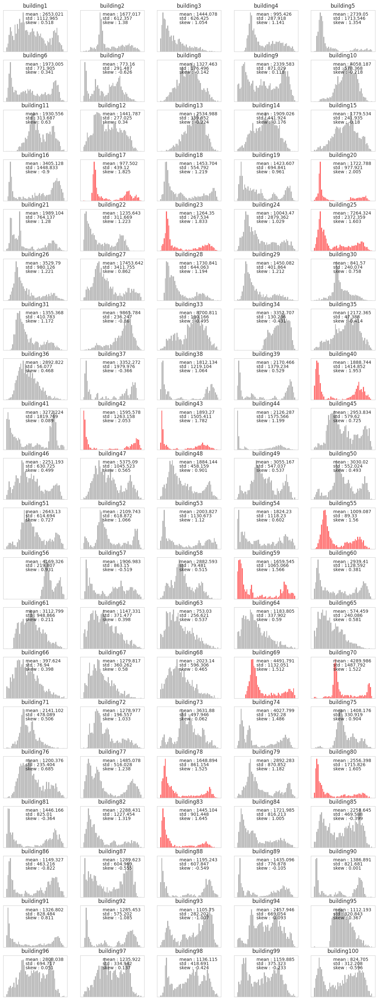

In [ ]:
sns.set_style('whitegrid')

fig = plt.figure(figsize = (15, 40))
skewness_positive = []
skewness_negative = []
for num in range(1,101):
    ax = plt.subplot(20, 5, num)
    energy = eda_df.loc[eda_df.num == num, 'target'].values
    mean = energy.mean().round(3)
    std = energy.std().round(3)
    skew = (3*(mean - np.median(energy))/energy.std()).round(3)
    if skew >= 1.5:
        plt.hist(energy, alpha = 0.7, bins = 50, color = 'red')
        skewness_positive.append(num)
    elif skew <= -1.5:
        plt.hist(energy, alpha = 0.7, bins = 50, color = 'blue')
        skewness_negative.append(num)
    else:
        plt.hist(energy, alpha = 0.7, bins = 50, color = 'gray')
    plt.title(f'building{num}')
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('')
    plt.ylabel('')
    plt.text(0.35, 0.9, f'mean : {mean}',  ha='left', va='center', transform=ax.transAxes)
    plt.text(0.35, 0.8, f'std : {std}',  ha='left', va='center', transform=ax.transAxes)
    plt.text(0.35, 0.7, f'skew : {skew}',  ha='left', va='center', transform=ax.transAxes)


print("positive skewed buildings: ",skewness_positive ) # result  [17, 20, 23, 25, 40, 42, 43, 55, 59, 69, 70, 78, 80, 83]
print("negative skewed buildings: ",skewness_negative ) # result  []

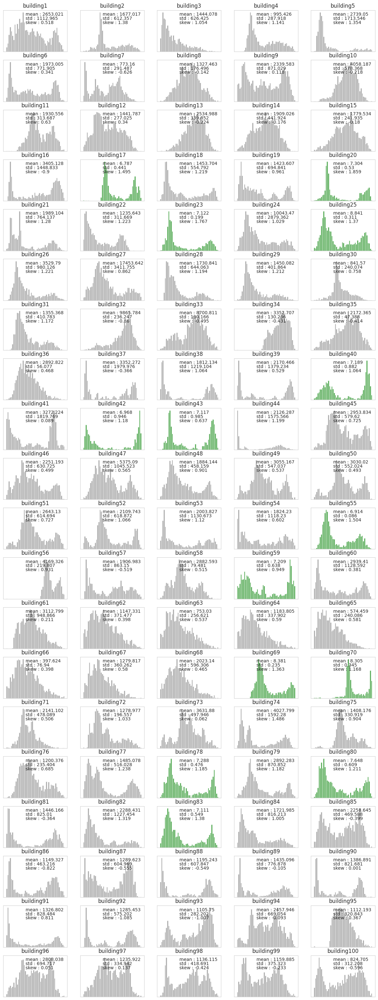

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Apply log transformation on positively skewed buildings
skewness_positive = [17, 20, 23, 25, 40, 42, 43, 55, 59, 69, 70, 78, 80, 83]
transformed_df = eda_df.copy()
for num in skewness_positive:
    mask = transformed_df['num'] == num
    transformed_df.loc[mask, 'target'] = np.log1p(transformed_df.loc[mask, 'target'])

sns.set_style('whitegrid')

fig = plt.figure(figsize=(15, 40))

for num in range(1, 101):
    ax = plt.subplot(20, 5, num)
    energy = transformed_df.loc[transformed_df.num == num, 'target'].values

    # Plot the histogram
    if num in skewness_positive:
        color = 'green'
    else:
        color = 'gray'
    plt.hist(energy, alpha=0.7, bins=50, color=color)

    mean = energy.mean().round(3)
    std = energy.std().round(3)
    skew = (3 * (mean - np.median(energy)) / energy.std()).round(3)

    plt.title(f'building{num}')
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('')
    plt.ylabel('')
    plt.text(0.35, 0.9, f'mean : {mean}', ha='left', va='center', transform=ax.transAxes)
    plt.text(0.35, 0.8, f'std : {std}', ha='left', va='center', transform=ax.transAxes)
    plt.text(0.35, 0.7, f'skew : {skew}', ha='left', va='center', transform=ax.transAxes)

plt.show()

## energy usage of each building

horizontal axis indicates hour <br>
vertivcal axis indicates weekday


conclusion: 이상치가 존재하니 같은 요일 같은 시간대 평균으로 채운다.

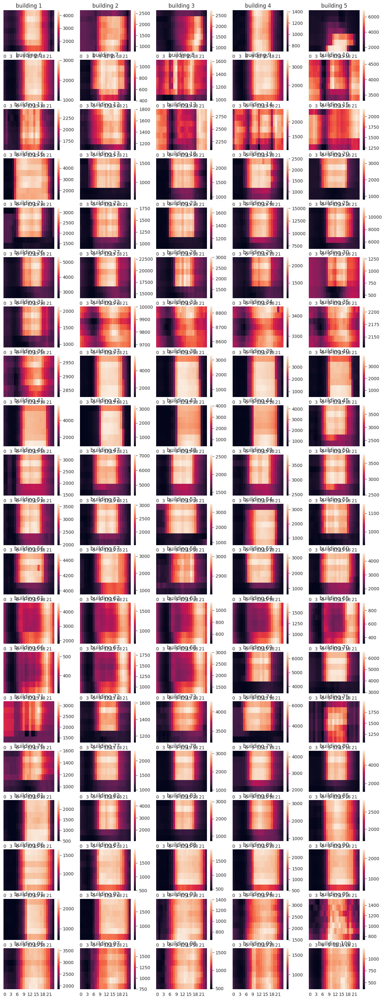

In [ ]:
fig = plt.figure(figsize = (15, 40))
for num in eda_df['num'].unique():
    df = eda_df[eda_df.num == num]
    df = df.groupby(['weekday', 'hour'])['target'].mean().reset_index().pivot('weekday', 'hour', 'target')
    plt.subplot(20, 5, num)
    sns.heatmap(df)
    plt.title(f'building {num}')
    plt.xlabel('')
    plt.ylabel('')
    plt.yticks([])

34번 건물 월, 56번 건물 수, 71번 건물 토요일에 약간의 이상치 발견. <br>
 일시적인 것인지 확인해본다

<Axes: xlabel='datetime', ylabel='target'>

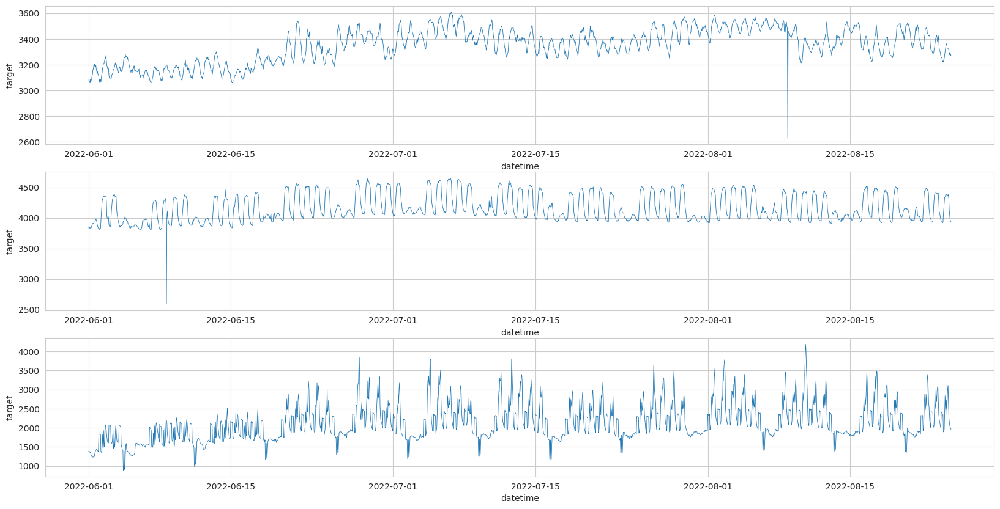

In [ ]:

num_34 = eda_df[eda_df.num == 34]
num_56 = eda_df[eda_df.num == 56]
num_71 = eda_df[eda_df.num == 71]
fig = plt.figure(figsize = (20, 10))
plt.subplot(311)
sns.lineplot(data = num_34, x = 'datetime', y = 'target', linewidth = 0.6)
plt.subplot(312)
sns.lineplot(data = num_56, x = 'datetime', y = 'target', linewidth = 0.6)
plt.subplot(313)
sns.lineplot(data = num_71, x = 'datetime', y = 'target', linewidth = 0.6)

확인 결과 71번은 내 눈 문제였고, 34 56은 일시적인 이상치 발생으로 보인다.

히트맵은 잘 안보이니 그래프로도 확인해보자

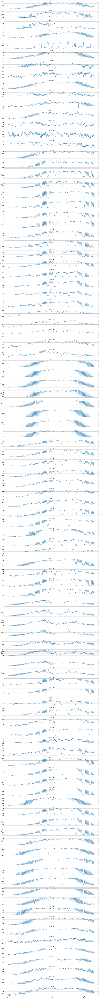

In [ ]:
import math

rows = 100
cols = 1
fig, axes = plt.subplots(rows, cols, sharex=True, sharey=False, figsize=(20,200))

# Only show labels on the edge subplots
for ax in axes.flat:
    ax.label_outer()

for num in range(1, 101):
    num_df = eda_df[eda_df.num == num]

    row = (num - 1) // cols
    ax = axes[row]

    sns.lineplot(data = num_df, x = 'datetime', y = 'target', linewidth = 0.6, ax=ax)
    ax.set_title(f'Building {num}')
    ax.tick_params(axis='x', rotation=45)
    ax.set_ylim(num_df['target'].min(), num_df['target'].max())

fig.tight_layout()
plt.show()

## Clustering

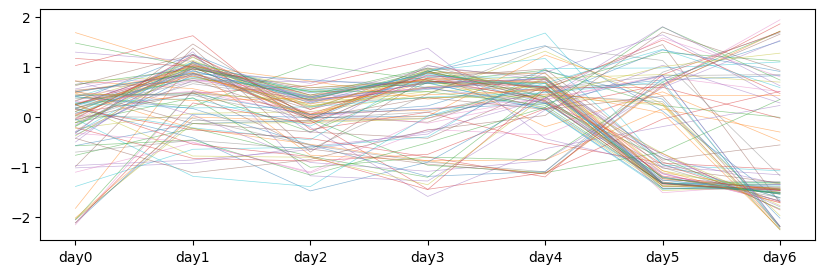

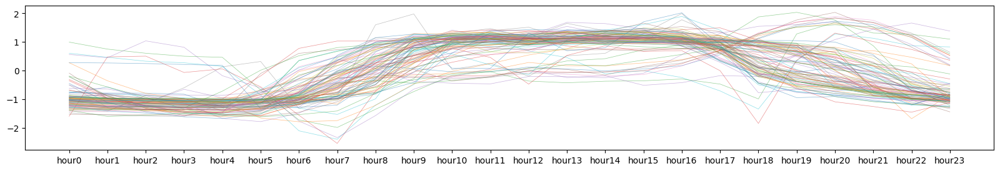

In [ ]:
by_weekday = eda_df.groupby(['num','weekday'])['target'].median().reset_index().pivot('num','weekday','target').reset_index()
by_hour = eda_df.groupby(['num','hour'])['target'].median().reset_index().pivot('num','hour','target').reset_index().drop('num', axis = 1)
df = pd.concat([by_weekday, by_hour], axis= 1)
columns = ['num'] + ['day'+str(i) for i in range(7)] + ['hour'+str(i) for i in range(24)]
df.columns = columns

# '전력사용량'이 아닌 '요일과 시간대에 따른 전력 사용량의 경향성'에 따라서만 군집화 할 것이므로, 특수한 scaling이 필요함
# standard scaling
for i in range(len(df)):
    # 요일 별 전력 중앙값에 대해 scaling
    df.iloc[i,1:8] = (df.iloc[i,1:8] - df.iloc[i,1:8].mean())/df.iloc[i,1:8].std()
    # 시간대별 전력 중앙값에 대해 scaling
    df.iloc[i,8:] = (df.iloc[i,8:] - df.iloc[i,8:].mean())/df.iloc[i,8:].std()

# visualization
fig = plt.figure(figsize = (10,3))
for i in range(len(df)):
    plt.plot(df.iloc[i, 1:8], alpha = 0.5, linewidth = 0.5)
fig = plt.figure(figsize = (20,3))
for i in range(len(df)):
    plt.plot(df.iloc[i, 8:], alpha = 0.5, linewidth = 0.5)

주말에 줄어드는 경우도 있고, 늘어나는 경우도 있다.

대부분이 9시 ~ 18시 정도에 피크지만, 밤 시간대가 피크인 경우도 있다.  

kmeans clustering

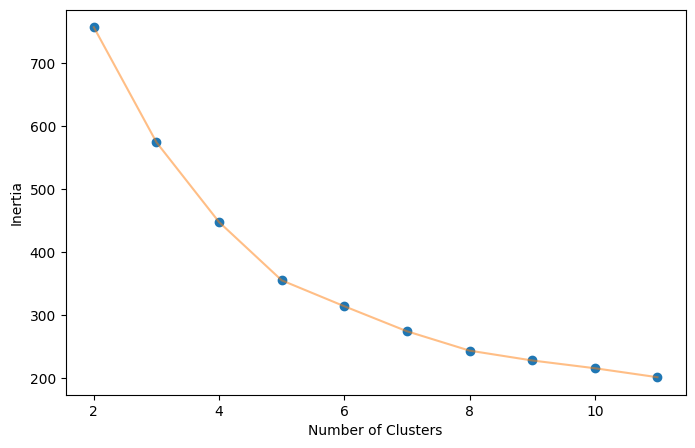

In [ ]:
# elbow method를 통해 군집의 개수 결정
from sklearn.cluster import KMeans
def change_n_clusters(n_clusters, data):
    sum_of_squared_distance = []
    for n_cluster in n_clusters:
        kmeans = KMeans(n_clusters=n_cluster)
        kmeans.fit(data)
        sum_of_squared_distance.append(kmeans.inertia_)

    plt.figure(1 , figsize = (8, 5))
    plt.plot(n_clusters , sum_of_squared_distance , 'o')
    plt.plot(n_clusters , sum_of_squared_distance , '-' , alpha = 0.5)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Inertia')

change_n_clusters([2,3,4,5,6,7,8,9,10,11], df.iloc[:,1:])

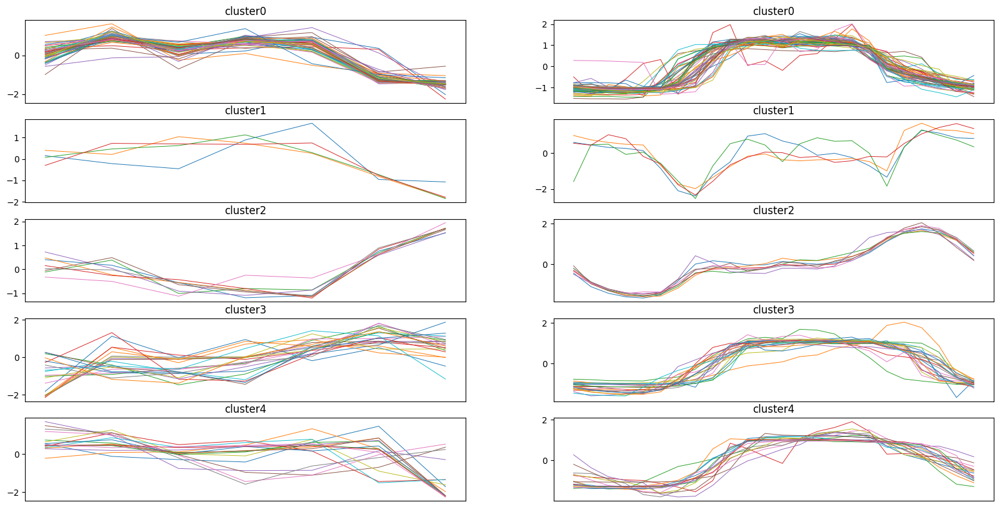

In [ ]:
kmeans = KMeans(n_clusters=5, random_state=2)
km_cluster = kmeans.fit_predict(df.iloc[:, 1:])

df_clust = df.copy()
df_clust['km_cluster'] = km_cluster

# visualizing result of kmeans clustering
n_c = len(np.unique(df_clust.km_cluster))



fig = plt.figure(figsize=(20, 10))
for c in range(n_c):
    temp = df_clust[df_clust.km_cluster == c]
    plt.subplot(n_c, 2, 2 * c + 1)
    #Day 기준
    for i in range(len(temp)):
        plt.plot(temp.iloc[i, 1:8], linewidth=0.7)
        plt.title(f'cluster{c}')
        plt.xlabel('')
        plt.xticks([])

    plt.subplot(n_c, 2, 2 * c + 2)
    #Hour 기준
    for i in range(len(temp)):
        plt.plot(temp.iloc[i, 8:-1], linewidth=0.7)
        plt.title(f'cluster{c}')
        plt.xlabel('')
        plt.xticks([])

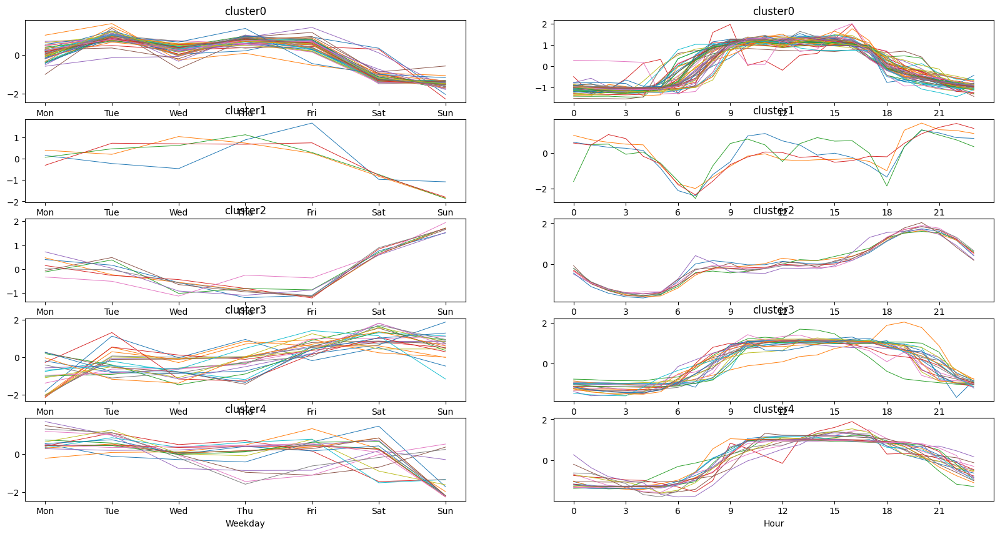

In [ ]:
import numpy as np

# Create weekday and hour labels
weekdays = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
hours = np.arange(0, 24)

fig = plt.figure(figsize=(20, 10))
for c in range(n_c):
    temp = df_clust[df_clust.km_cluster == c]

    # Plot left graph (Day-based)
    plt.subplot(n_c, 2, 2 * c + 1)
    for i in range(len(temp)):
        plt.plot(temp.iloc[i, 1:8], linewidth=0.7)
    plt.title(f'cluster{c}')
    plt.xlabel('Weekday')
    plt.xticks(np.arange(len(weekdays)), labels=weekdays)  # Set weekday labels as x-axis ticks

    # Plot right graph (Hour-based)
    plt.subplot(n_c, 2, 2 * c + 2)
    for i in range(len(temp)):
        plt.plot(temp.iloc[i, 8:-1], linewidth=0.7)
    plt.title(f'cluster{c}')
    plt.xlabel('Hour')
    plt.xticks(np.arange(0, 24, 3), labels=np.arange(0, 24, 3))  # Set hour labels as x-axis ticks

plt.show()

In [ ]:
# Get the unique cluster numbers
clusters = np.unique(km_cluster)

# Create a dictionary to store the building numbers per cluster
buildings_per_cluster = {}

# Iterate over each cluster
for cluster_number in clusters:
    # Get the index of the buildings that belong to the current cluster
    building_indices = np.where(km_cluster == cluster_number)[0]

    # Store this in the dictionary with the cluster number as the key
    buildings_per_cluster[cluster_number] = building_indices

# Print the result
for cluster_number, buildings in buildings_per_cluster.items():
    print(f"Cluster {cluster_number}: {', '.join(map(str, buildings))}")

Cluster 0: 0, 3, 6, 7, 10, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 44, 45, 46, 47, 48, 49, 50, 51, 52, 54, 55, 57, 58, 59, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 81, 82, 83
Cluster 1: 9, 12, 13, 14
Cluster 2: 60, 61, 62, 63, 64, 65, 66, 67
Cluster 3: 1, 2, 4, 36, 37, 38, 39, 40, 41, 42, 43, 53, 80, 84, 92, 93, 94, 95, 96, 97, 98, 99
Cluster 4: 5, 8, 11, 29, 31, 32, 33, 34, 35, 56, 85, 86, 87, 88, 89, 90, 91


In [ ]:
eda_df = eda_df.merge(df_clust[['num','km_cluster']], on = 'num', how = 'left')
eda_df.columns

Index(['num_datetime', 'num', '일시', 'temperature', 'precipitation',
       'windspeed', 'humidity', 'target', 'building_category', 'area',
       'cooling_area', 'solar', 'ESS_storage', 'PCS_storage', 'datetime',
       'weekday', 'month', 'hour', 'date', 'weekend', 'km_cluster'],
      dtype='object')

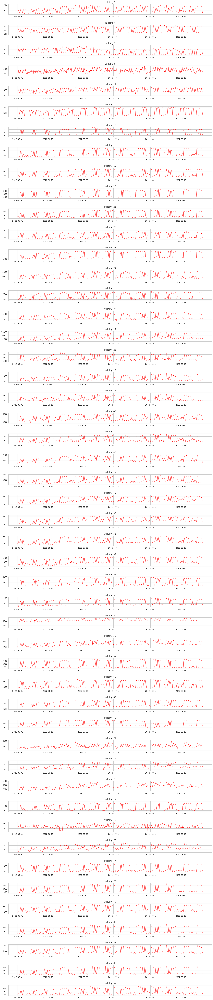

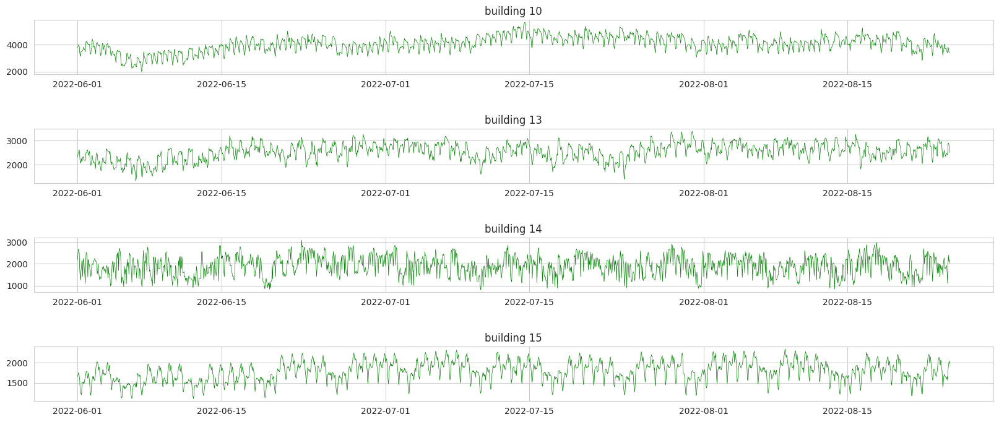

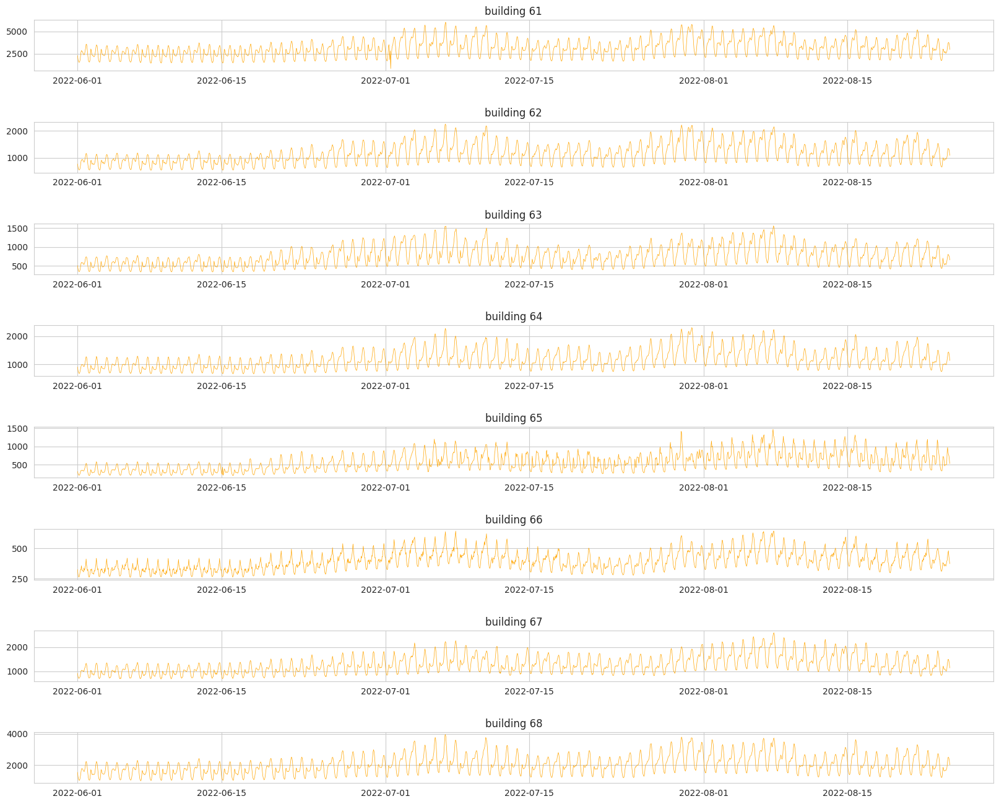

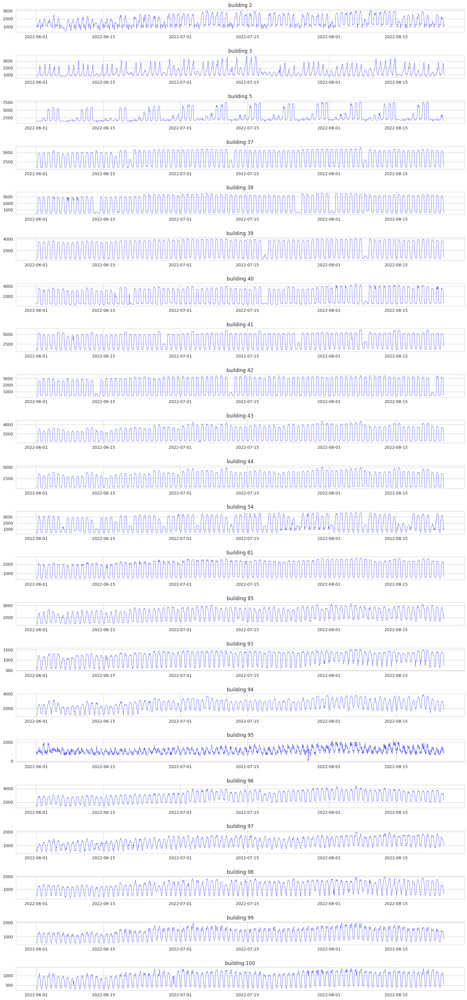

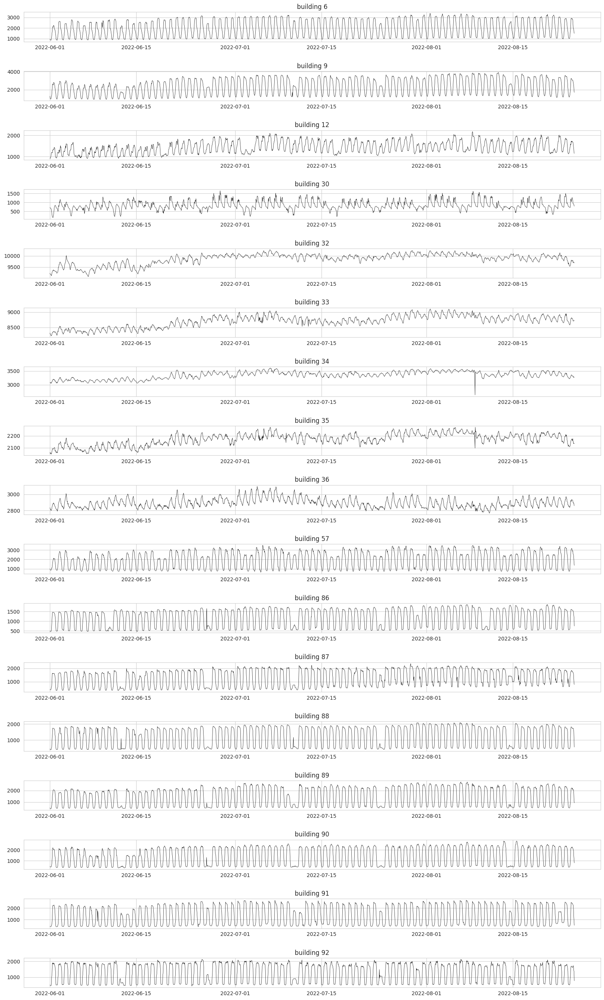

In [ ]:

# dictionary mapping cluster and building
match = df_clust[['num','km_cluster']]
clust_to_num = {0:[],1:[],2:[],3:[],4:[]}
for i in range(100):
    c = match.iloc[i,1]
    clust_to_num[c].append(i+1)

# linplot(energy usage of each building ~ cluster, datetime)
for c, col in enumerate(['red','green','orange','blue','black']):
    temp_1 = eda_df[eda_df.km_cluster == c]
    nums = np.unique(temp_1.num)
    n_nums = len(nums)
    fig = plt.figure(figsize = (20, 2*n_nums))
    for i, num in enumerate(nums):
        temp_2 = temp_1[temp_1.num == num]
        plt.subplot(n_nums,1, i+1)
        sns.lineplot(data = temp_2, x= 'datetime', y = 'target', linewidth = 0.5, color = col)
        plt.title(f'building {num}')
        plt.subplots_adjust(hspace = 1)
        plt.ylabel('')
        plt.xlabel('')


같은 군집이어도 때로 건물 마다 매우 상이한 패턴을 보이므로, 각 건물 별 모델링이 필요해 보인다.

이상치가 있으므로 제거 작업이 필요해 보인다: 34, 35, 56, 70, 86 등

10, 13, 14 건물은 패턴이 쉽게 눈에 보이지 않는다.

37~44 백화점은 n번째 주 x요일 처럼 휴무를 하는 듯하다. 학습할 때 week와 weekday를 모두 제공해야 한다.

## CORR

스피어만 상관계수 (ordinal)

In [ ]:
# cluster 0
df_0 = eda_df[eda_df.km_cluster == 0]
df = df_0.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_0 = []
for num in clust_to_num[0]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(spearmanr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_0.append(corr)
# cluster 1
df_1 = eda_df[eda_df.km_cluster == 1]
df = df_1.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_1 = []
for num in clust_to_num[1]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(spearmanr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_1.append(corr)
# cluster 2
df_2 = eda_df[eda_df.km_cluster == 2]
df = df_2.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_2 = []
for num in clust_to_num[2]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(spearmanr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_2.append(corr)
# cluster 3
df_3 = eda_df[eda_df.km_cluster == 3]
df = df_3.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_3 = []
for num in clust_to_num[3]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(spearmanr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_3.append(corr)
# cluster 4
df_4 = eda_df[eda_df.km_cluster == 4]
df = df_4.groupby(['num', 'date'])['temperature', 'humidity', 'windspeed', 'precipitation', 'target'].mean().reset_index()
corrs_4 = []
for num in clust_to_num[4]:
    corr = []
    corr.append(num)
    for feat in ['temperature', 'humidity', 'windspeed','precipitation']:
        corr.append(spearmanr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_4.append(corr)

corrs_total = [corrs_0, corrs_1, corrs_2, corrs_3, corrs_4]  # Add corrs_4 to the corrs_total list


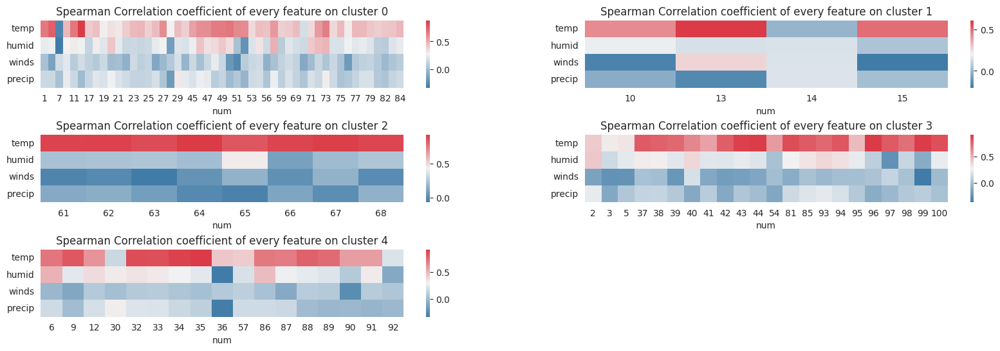

In [ ]:
fig = plt.figure(figsize = (20, 6))
for i, corrs in enumerate(corrs_total):
    corr_df = pd.DataFrame(np.array(corrs), columns = ['num','temp','humid','winds','precip'])
    corr_df['num'] = corr_df['num'].astype(int)
    corr_df = corr_df.set_index('num')

    plt.subplot(3,2,i+1)
    sns.heatmap(corr_df.transpose(), cmap=sns.diverging_palette(240,10,as_cmap=True))
    plt.subplots_adjust(hspace = 0.7)
    plt.title(f'Spearman Correlation coefficient of every feature on cluster {i}')

피어슨 상관계수 (cardinal)

In [ ]:
from scipy.stats import pearsonr

# cluster 0
df_0 = eda_df[eda_df.km_cluster == 0]
df = df_0.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_0 = []
for num in clust_to_num[0]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(pearsonr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_0.append(corr)
# cluster 1
df_1 = eda_df[eda_df.km_cluster == 1]
df = df_1.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_1 = []
for num in clust_to_num[1]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(pearsonr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_1.append(corr)
# cluster 2
df_2 = eda_df[eda_df.km_cluster == 2]
df = df_2.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_2 = []
for num in clust_to_num[2]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(pearsonr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_2.append(corr)
# cluster 3
df_3 = eda_df[eda_df.km_cluster == 3]
df = df_3.groupby(['num','date'])['temperature','humidity','windspeed','precipitation','target'].mean().reset_index()
corrs_3 = []
for num in clust_to_num[3]:
    corr = []
    corr.append(num)
    for feat in ['temperature','humidity','windspeed','precipitation']:
        corr.append(pearsonr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_3.append(corr)
# cluster 4
df_4 = eda_df[eda_df.km_cluster == 4]
df = df_4.groupby(['num', 'date'])['temperature', 'humidity', 'windspeed', 'precipitation', 'target'].mean().reset_index()
corrs_4 = []
for num in clust_to_num[4]:
    corr = []
    corr.append(num)
    for feat in ['temperature', 'humidity', 'windspeed','precipitation']:
        corr.append(pearsonr(df.loc[df.num == num, feat], df.loc[df.num == num, 'target']).correlation)
    corrs_4.append(corr)

corrs_total = [corrs_0, corrs_1, corrs_2, corrs_3, corrs_4]  # Add corrs_4 to the corrs_total list

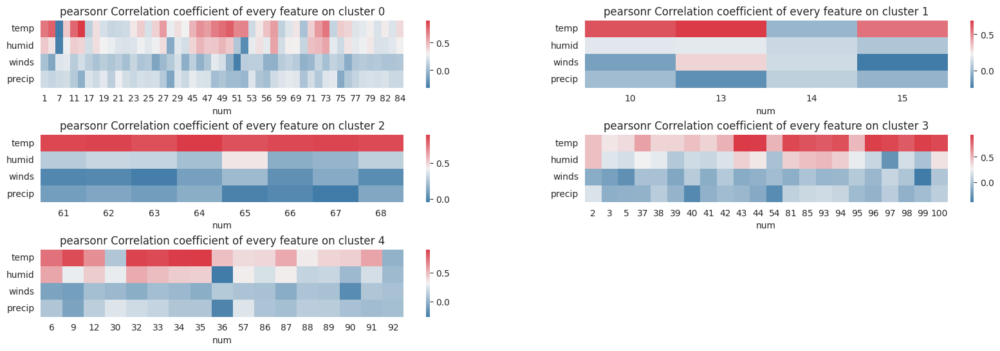

In [ ]:
fig = plt.figure(figsize = (20, 6))
for i, corrs in enumerate(corrs_total):
    corr_df = pd.DataFrame(np.array(corrs), columns = ['num','temp','humid','winds','precip'])
    corr_df['num'] = corr_df['num'].astype(int)
    corr_df = corr_df.set_index('num')

    plt.subplot(3,2,i+1)
    sns.heatmap(corr_df.transpose(), cmap=sns.diverging_palette(240,10,as_cmap=True))
    plt.subplots_adjust(hspace = 0.7)
    plt.title(f'pearsonr Correlation coefficient of every feature on cluster {i}')

각 정보의 상관관계 역시 건물마다 조금씩 다르게 나타난다.

일평균 기온과 일평균 전력은 어떨까?

In [ ]:
# 날짜별로 일평균 기온과 일평균 전력 사용량의 상관관계 파악
temp_1 = eda_df[eda_df.km_cluster == 0]
nums = np.unique(temp_1.num)
n_nums = len(nums)
fig = plt.figure(figsize = (16, 3*(n_nums//5 + 1)))
plt.suptitle('cluster 0')
for i, num in enumerate(nums):
    temp_2 = temp_1[temp_1.num == num]
    temp_2 = temp_2.groupby(['num','date','weekend'])[['target','temperature']].mean().reset_index()
    plt.subplot(n_nums//5+1,5, i+1)
    sns.scatterplot(data = temp_2, x='temperature', y='target', hue= 'weekend')
    plt.title(f'building {num}')
    plt.ylabel('')
    plt.xlabel('')
    plt.subplots_adjust(hspace = 0.5)
fig = plt.figure(figsize = (16, 4))

temp_1 = eda_df[eda_df.km_cluster == 1]
nums = np.unique(temp_1.num)
n_nums = len(nums)
fig = plt.figure(figsize = (16, 3*(n_nums//5 + 1)))
plt.suptitle('cluster 1')
for i, num in enumerate(nums):
    temp_2 = temp_1[temp_1.num == num]
    temp_2 = temp_2.groupby(['num','date','weekend'])[['target','temperature']].mean().reset_index()
    plt.subplot(n_nums//5+1,5, i+1)
    sns.scatterplot(data = temp_2, x='temperature', y='target', hue= 'weekend')
    plt.title(f'building {num}')
    plt.ylabel('')
    plt.xlabel('')
    plt.subplots_adjust(hspace = 0.5)
fig = plt.figure(figsize = (16, 8))

temp_1 = eda_df[eda_df.km_cluster == 2]
nums = np.unique(temp_1.num)
n_nums = len(nums)
fig = plt.figure(figsize = (16, 3*(n_nums//5 + 1)))
plt.suptitle('cluster 2')
for i, num in enumerate(nums):
    temp_2 = temp_1[temp_1.num == num]
    temp_2 = temp_2.groupby(['num','date','weekend'])[['target','temperature']].mean().reset_index()
    plt.subplot(n_nums//5+1,5, i+1)
    sns.scatterplot(data = temp_2, x='temperature', y='target', hue= 'weekend')
    plt.title(f'building {num}')
    plt.ylabel('')
    plt.xlabel('')
    plt.subplots_adjust(hspace = 0.5)
fig = plt.figure(figsize = (16, 30))

temp_1 = eda_df[eda_df.km_cluster == 3]
nums = np.unique(temp_1.num)
n_nums = len(nums)
fig = plt.figure(figsize = (16, 3*(n_nums//5 + 1)))
plt.suptitle('cluster 3')
for i, num in enumerate(nums):
    temp_2 = temp_1[temp_1.num == num]
    temp_2 = temp_2.groupby(['num','date','weekend'])[['target','temperature']].mean().reset_index()
    plt.subplot(n_nums//5+1,5, i+1)
    sns.scatterplot(data = temp_2, x='temperature', y='target', hue= 'weekend')
    plt.title(f'building {num}')
    plt.ylabel('')
    plt.xlabel('')
    plt.subplots_adjust(hspace = 0.5)

## 최근 시간대 자세히 보기

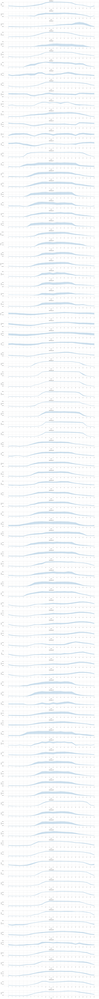

In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns

rows = 100
cols = 1
fig, axes = plt.subplots(rows, cols, sharey=False, figsize=(20, 200))

for num in range(1, 101):
    num_df = eda_df[eda_df.num == num].iloc[1800:]

    row = (num - 1) // cols
    ax = axes[row]

    sns.lineplot(data=num_df, x='hour', y='target', linewidth=0.6, ax=ax)
    ax.set_title(f'Building {num}')
    ax.tick_params(axis='x', rotation=45)
    ax.set_ylim(num_df['target'].min(), num_df['target'].max())

    ax.set_xticks(range(0, 24))  # Set x-axis ticks for each subplot to display every hour
    ax.set_xlabel('Hour')

fig.tight_layout()
plt.show()

# Data 전처리

데이터 전처리

참고 사이트:
https://tips.energy.or.kr/egydata/guide.do



In [ ]:
import pandas as pd
import numpy as np
import math
from datetime import datetime
from math import ceil

# n번째 주 x요일 처럼 쉬는 건물(백화점)이 있어 해당 달에서 몇 번째 주인지 확인하는 함수
def week_of_month(dt):
    first_day = dt.replace(day=1)
    dom = dt.day
    adjusted_dom = dom + first_day.weekday()
    return int(ceil(adjusted_dom/7.0))

# 평균과 비교하여 Threshold * 표준편차를 넘어서는 이상치 제거 함수
def is_outlier(value, mean, std_dev, threshold=15):
    return abs(value - mean) > (threshold * std_dev)

#시간을 순환으로 바꾸기 위한 함수. 23시->0시 는 크게 다르지 않다.
def add_cyclic_time_features(df):
    hours_in_day = 24
    df['sin_time'] = np.sin(2 * np.pi * df['time'] / hours_in_day)
    df['cos_time'] = np.cos(2 * np.pi * df['time'] / hours_in_day)
    return df

#냉방도시간, 12window size로 측정하는 냉방 수요 지수
def CDH(xs):
    base_temper = 24
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-base_temper))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-base_temper))
    return ys

#공휴일 여부 확인
def is_holiday(date, holiday_list):
    return 1 if (date in holiday_list) else 0

# 공휴일 - 주말을 빼는 경우보다 같이 넣는 경우가 결과가 좋았다.
holidays = ['20220601', '20220606', '20220815',
             '20220604', '20220605',
 '20220611', '20220612', '20220618', '20220619',
 '20220625', '20220626', '20220702', '20220703',
 '20220709', '20220710', '20220716', '20220717',
 '20220723', '20220724', '20220730', '20220731',
 '20220806', '20220807', '20220813', '20220814',
 '20220820', '20220821', '20220827', '20220828']


#데이터 불러오기.
train_df = pd.read_csv('train.csv', encoding='cp949')
test_df = pd.read_csv('test.csv', encoding='cp949')

'''================= 데이터의 결측치 처리 ==================='''
#test 예측 시에 사용할 수 없는 일조, 일사 열 제거
train_df = train_df.drop(['일조(hr)','일사(MJ/m2)'], axis=1)

#매우 많은 강수량 결측값을 0으로 채웁니다
train_df['강수량(mm)'].fillna(0.0, inplace=True)
# 풍속, 습도 결측치 평균으로 채우고 반올림하기
train_df['풍속(m/s)'].fillna(round(train_df['풍속(m/s)'].mean(),2), inplace=True)
train_df['습도(%)'].fillna(round(train_df['습도(%)'].mean(),2), inplace=True)

'''================= 주, 월, 일, 시 나누기 ==================='''
train_df['일시'] = pd.to_datetime(train_df['일시'])
train_df['week'] = train_df['일시'].apply(week_of_month)
train_df['date'] =  train_df['일시'].dt.day
train_df['weekday'] = train_df['일시'].dt.weekday
train_df['month'] = train_df['일시'].dt.month
train_df['time'] = train_df['일시'].dt.hour

test_df['일시'] = pd.to_datetime(test_df['일시'])
test_df['week'] = test_df['일시'].apply(week_of_month)
test_df['date'] =  test_df['일시'].dt.day
test_df['weekday'] = test_df['일시'].dt.weekday
test_df['month'] = test_df['일시'].dt.month
test_df['time'] = test_df['일시'].dt.hour

train_df['datetime'] = train_df['일시'].dt.strftime('%Y-%m-%d')
test_df['datetime'] = test_df['일시'].dt.strftime('%Y-%m-%d')

#휴무 여부 넣어주기
train_df['holiday'] = train_df['일시'].dt.strftime('%Y-%m-%d').apply(lambda x: int(x.replace('-', ''))).apply(lambda x: is_holiday(str(x), holidays))
test_df['holiday'] = test_df['일시'].dt.strftime('%Y-%m-%d').apply(lambda x: int(x.replace('-', ''))).apply(lambda x: is_holiday(str(x), holidays))


#2, 4 번째 일요일 휴무인 건물 존재
train_df['is_2nd_or_4th_sunday'] = 0
second_sundays = (train_df['weekday'] == 6) & (8 <= train_df['date']) & (train_df['date'] <= 14)
fourth_sundays = (train_df['weekday'] == 6) & (22 <= train_df['date']) & (train_df['date'] <= 28)
train_df.loc[second_sundays | fourth_sundays, 'is_2nd_or_4th_sunday'] = 1
test_df['is_2nd_or_4th_sunday'] = 0
second_sundays = (test_df['weekday'] == 6) & (8 <= test_df['date']) & (test_df['date'] <= 14)
fourth_sundays = (test_df['weekday'] == 6) & (22 <= test_df['date']) & (test_df['date'] <= 28)
test_df.loc[second_sundays | fourth_sundays, 'is_2nd_or_4th_sunday'] = 1
#1,3번째 일요일에 휴무인 건물
train_df['is_1st_or_3rd_sunday'] = 0
first_sundays = (train_df['weekday'] == 6) & (1 <= train_df['date']) & (train_df['date'] <= 7)
third_sundays = (train_df['weekday'] == 6) & (15 <= train_df['date']) & (train_df['date'] <= 21)
train_df.loc[first_sundays | third_sundays, 'is_1st_or_3rd_sunday'] = 1
test_df['is_1st_or_3rd_sunday'] = 0
first_sundays = (test_df['weekday'] == 6) & (1 <= test_df['date']) & (test_df['date'] <= 7)
third_sundays = (test_df['weekday'] == 6) & (15 <= test_df['date']) & (test_df['date'] <= 21)
test_df.loc[first_sundays | third_sundays, 'is_1st_or_3rd_sunday'] = 1


# 시간을 순환하도록
train_df = add_cyclic_time_features(train_df)
test_df = add_cyclic_time_features(test_df)


'''================= 각각 건물로 Train 데이터 나누기 ==================='''
'''================= train과 test에 모두 featuring 진행 ==================='''
train_dfs = {}
for building_number in range(1,101):
    train_dfs[building_number] = train_df[train_df['건물번호'] == building_number]
    #요일별 평균
    train_dfs[building_number]['weekday_hour_average'] = train_dfs[building_number].groupby(['weekday', 'time'])['전력소비량(kWh)'].transform('mean')
    #month_weekday_hour average
    train_dfs[building_number]['month_weekday_hour_average'] = train_dfs[building_number].groupby(['month', 'weekday', 'time'])['전력소비량(kWh)'].transform('mean')
    #month_weekday_hour std
    train_dfs[building_number]['month_weekday_hour_std'] = train_dfs[building_number].groupby(['month', 'weekday', 'time'])['전력소비량(kWh)'].transform('std')
    #week_weekday_hour average -몇 번째 주, 무슨 요일별 휴무가 있으니
    train_dfs[building_number]['week_weekday_hour_average'] = train_dfs[building_number].groupby(['week', 'weekday', 'time'])['전력소비량(kWh)'].transform('mean')
    #CDH
    cdh = CDH(train_dfs[building_number]['기온(C)'].values)
    train_dfs[building_number]['CDH'] = cdh
    # THI - 불쾌지수
    train_dfs[building_number]['THI'] = (
        9 / 5 * train_dfs[building_number]['기온(C)']
        - 0.55 * (1 - train_dfs[building_number]['습도(%)'] / 100)
        * (9 / 5 * train_dfs[building_number]['기온(C)'] - 26) + 32
    )
    '''
    train_dfs[building_number].loc[train_dfs[building_number]['THI'] < 68, 'THI'] = 0
    train_dfs[building_number].loc[(train_dfs[building_number]['THI'] >= 68) & (train_dfs[building_number]['THI'] < 75), 'THI'] = 1
    train_dfs[building_number].loc[(train_dfs[building_number]['THI'] >= 75) & (train_dfs[building_number]['THI'] < 80), 'THI'] = 2
    train_dfs[building_number].loc[train_dfs[building_number]['THI'] >= 80, 'THI'] = 3
    '''
    # 체감 온도
    train_dfs[building_number]['s-temperature'] = (
    13.12
    + 0.6215 * train_dfs[building_number]['기온(C)']
    - 11.37 * (train_dfs[building_number]['풍속(m/s)'] * 3.6) ** 0.16
    + 0.3965 * (train_dfs[building_number]['풍속(m/s)'] * 3.6) ** 0.16 * train_dfs[building_number]['기온(C)']
    )
    #미분 - 안하는게 결과가 좋았다.
    '''
    train_dfs[building_number]['기온(C)'] = train_dfs[building_number]['기온(C)'].diff()
    train_dfs[building_number]['풍속(m/s)'] = train_dfs[building_number][	'풍속(m/s)'].diff()
    train_dfs[building_number]['습도(%)'] = train_dfs[building_number]['습도(%)'].diff()
    train_dfs[building_number]['CDH'] = train_dfs[building_number]['CDH'].diff()
    train_dfs[building_number]['THI'] = train_dfs[building_number]['THI'].diff()
    train_dfs[building_number]['s-temperature'] = train_dfs[building_number]['s-temperature'].diff()
    train_dfs[building_number] = train_dfs[building_number].dropna()
    '''
     #EDA에서 직접 눈으로 확인한 이상치들 제거
    if(building_number == 34):
        condition = train_dfs[building_number]['num_date_time'] == '34_20220808 21'
        train_dfs[building_number].loc[condition, '전력소비량(kWh)'] = train_dfs[building_number].loc[condition, 'weekday_hour_average']
    if(building_number == 56):
        condition = train_dfs[building_number]['num_date_time'] == '56_20220608 16'
        train_dfs[building_number].loc[condition, '전력소비량(kWh)'] = train_dfs[building_number].loc[condition, 'weekday_hour_average']
    if(building_number == 75):
        condition = train_dfs[building_number]['num_date_time'] == '75_20220730 17'
        train_dfs[building_number].loc[condition, '전력소비량(kWh)'] = train_dfs[building_number].loc[condition, 'weekday_hour_average']
    #이상치가 한 두개가 아니라 대체 할 수 없을 경우 그 구간을 빼준다.
    if building_number == 70:
        start_date = '2022-07-29'
        end_date = '2022-08-08'
        mask = ~((train_dfs[building_number]['일시'] >= start_date) & (train_dfs[building_number]['일시'] <= end_date))
        filtered_data = train_dfs[building_number][mask]
    if building_number == 7:
        start_date = '2022-07-05'
        mask = ((train_dfs[building_number]['일시'] >= start_date))
        filtered_data = train_dfs[building_number][mask]
    if building_number == 75:
        start_date = '2022-07-01'
        mask = ((train_dfs[building_number]['일시'] >= start_date))
        filtered_data = train_dfs[building_number][mask]


#TEST 에도 같은 featuring 작업을 해준다.
test_dfs = {}
for building_number in range(1, 101):
    test_dfs[building_number] = test_df[test_df['건물번호'] == building_number]
    #요일별 평균
    tmp = train_dfs[building_number][ ['weekday', 'time', 'weekday_hour_average'] ].drop_duplicates()
    test_dfs[building_number] = test_dfs[building_number].merge(tmp, on=['weekday', 'time'], how='left')
    #month_hour average - train_dfs 에서 8월 정보를 가져온다.
    tmp = train_dfs[building_number][(train_dfs[building_number]['month'] == 8)][['건물번호', 'weekday', 'time', 'month_weekday_hour_average']].drop_duplicates()
    test_dfs[building_number] = test_dfs[building_number].merge(tmp, on=['건물번호', 'weekday', 'time'], how='left')
    #month_hour std
    tmp = train_dfs[building_number][(train_dfs[building_number]['month'] == 8)][['건물번호', 'weekday', 'time', 'month_weekday_hour_std']].drop_duplicates()
    test_dfs[building_number] = test_dfs[building_number].merge(tmp, on=['건물번호', 'weekday', 'time'], how='left')
    #week_weekday_hour average
    tmp = train_dfs[building_number][ ['week', 'weekday', 'time', 'week_weekday_hour_average'] ].drop_duplicates()
    test_dfs[building_number] = test_dfs[building_number].merge(tmp, on=['week', 'weekday', 'time'], how='left')
    # CDH
    cdh = CDH(test_dfs[building_number]['기온(C)'].values)
    test_dfs[building_number]['CDH'] = cdh
    # THI - 불쾌지수
    test_dfs[building_number]['THI'] = (
        9 / 5 * test_dfs[building_number]['기온(C)']
        - 0.55 * (1 - test_dfs[building_number]['습도(%)'] / 100)
        * (9 / 5 * test_dfs[building_number]['기온(C)'] - 26) + 32
    )
    '''
    test_dfs[building_number].loc[test_dfs[building_number]['THI'] < 68, 'THI'] = 0
    test_dfs[building_number].loc[(test_dfs[building_number]['THI'] >= 68) & (test_dfs[building_number]['THI'] < 75), 'THI'] = 1
    test_dfs[building_number].loc[(test_dfs[building_number]['THI'] >= 75) & (test_dfs[building_number]['THI'] < 80), 'THI'] = 2
    test_dfs[building_number].loc[test_dfs[building_number]['THI'] >= 80, 'THI'] = 3
    '''
    #체감온도
    test_dfs[building_number]['s-temperature'] = (
    13.12
    + 0.6215 * test_dfs[building_number]['기온(C)']
    - 11.37 * (test_dfs[building_number]['풍속(m/s)'] * 3.6) ** 0.16
    + 0.3965 * (test_dfs[building_number]['풍속(m/s)'] * 3.6) ** 0.16 * test_dfs[building_number]['기온(C)']
    )
    #미분
    '''
    #기온 미분으로 첫 행이 없어지므로 하나 붙여준다.
    last_rows_train =  train_dfs[building_number].tail(1)
    last_rows_train = last_rows_train[test_df.columns]
    test_dfs[building_number] = pd.concat([last_rows_train, test_dfs[building_number]], ignore_index=True)

    test_dfs[building_number]['기온(C)'] = test_dfs[building_number]['기온(C)'].diff()
    test_dfs[building_number][	'풍속(m/s)'] = test_dfs[building_number][	'풍속(m/s)'].diff()
    test_dfs[building_number]['습도(%)'] = test_dfs[building_number]['습도(%)'].diff()
    test_dfs[building_number]['CDH'] = test_dfs[building_number]['CDH'].diff()
    test_dfs[building_number]['THI'] = test_dfs[building_number]['THI'].diff()
    test_dfs[building_number]['s-temperature'] = test_dfs[building_number]['s-temperature'].diff()

    test_dfs[building_number] = test_dfs[building_number].dropna()
    '''



test_dfs[1]

<ipython-input-3-545f7cd23448>:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_dfs[building_number]['weekday_hour_average'] = train_dfs[building_number].groupby(['weekday', 'time'])['전력소비량(kWh)'].transform('mean')
<ipython-input-3-545f7cd23448>:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_dfs[building_number]['month_weekday_hour_average'] = train_dfs[building_number].groupby(['month', 'weekday', 'time'])['전력소비량(kWh)'].transform('mean')
<ipython-input-3-545f7cd23448>:123: SettingWithCopy

,num_date_time,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%),week,date,weekday,...,is_1st_or_3rd_sunday,sin_time,cos_time,weekday_hour_average,month_weekday_hour_average,month_weekday_hour_std,week_weekday_hour_average,CDH,THI,s-temperature
0,1_20220825 00,1,2022-08-25 00:00:00,23.5,0.0,2.2,72,4,25,3,...,0,0.000000,1.000000,1627.800000,1914.40,127.192151,1534.80,-0.5,71.78980,24.867486
1,1_20220825 01,1,2022-08-25 01:00:00,23.0,0.0,0.9,72,4,25,3,...,0,0.258819,0.965926,1550.080000,1845.76,131.129054,1461.84,-1.5,71.02840,24.698272
2,1_20220825 02,1,2022-08-25 02:00:00,22.7,0.0,1.5,75,4,25,3,...,0,0.500000,0.866025,1431.120000,1695.04,121.674398,1320.72,-2.8,70.81675,24.124701
3,1_20220825 03,1,2022-08-25 03:00:00,22.1,0.0,1.3,78,4,25,3,...,0,0.707107,0.707107,1372.200000,1622.72,112.621476,1268.40,-4.7,70.11262,23.517516
4,1_20220825 04,1,2022-08-25 04:00:00,21.8,0.0,1.0,77,4,25,3,...,0,0.866025,0.500000,1381.720000,1622.24,107.342353,1292.40,-6.9,69.56514,23.322268
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,1_20220831 19,1,2022-08-31 19:00:00,23.5,0.0,2.0,75,5,31,2,...,0,-0.965926,0.258819,2571.470769,2748.96,319.240779,2820.00,-12.5,72.05875,24.910736
164,1_20220831 20,1,2022-08-31 20:00:00,22.4,0.0,2.0,80,5,31,2,...,0,-0.866025,0.500000,2391.027692,2586.00,503.499409,2526.48,-10.0,70.74480,23.628937
165,1_20220831 21,1,2022-08-31 21:00:00,21.7,0.0,1.6,81,5,31,2,...,0,-0.707107,0.707107,1887.950769,2014.32,220.166221,1918.08,-8.6,69.69523,22.946290
166,1_20220831 22,1,2022-08-31 22:00:00,21.1,0.0,1.0,83,5,31,2,...,0,-0.500000,0.866025,1412.861538,1431.84,38.233640,1482.48,-9.0,68.85987,22.546535


# HyperParameter 튜닝

무료 GPU 시간 문제로 캐글에서 돌린 코드이다.

작년 대회 우승자의 코드를 참고하여 돌렸다
https://dacon.io/competitions/official/235736/codeshare/2877?page=1&dtype=recent

In [ ]:
!pip install sktime
import sys
import sktime
import tqdm as tq
import xgboost as xgb
import matplotlib
import seaborn as sns
import sklearn as skl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting import plot_series
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import xgboost as xgb
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import PredefinedSplit, GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.preprocessing import StandardScaler


기본 파라미터 튜닝
'n_estimators', 'eta', 'min_child_weight','max_depth', 'colsample_bytree', 'subsample'

In [ ]:

def SMAPE(true, pred):
    true = np.array(true).reshape(-1) # Convert true to a NumPy array and flatten it.
    pred = np.array(pred).reshape(-1) # Convert pred to a NumPy array and flatten it.
    return np.mean((np.abs(true - pred)) / (np.abs(true) + np.abs(pred))) * 100

smape = make_scorer(SMAPE, greater_is_better = False)

df = pd.DataFrame(columns = ['n_estimators', 'eta', 'min_child_weight','max_depth', 'colsample_bytree', 'subsample'])
preds = np.array([])

grid = {'n_estimators' : [100], 'eta' : [0.01], 'min_child_weight' : np.arange(1, 8, 1),
        'max_depth' : np.arange(3,9,1) , 'colsample_bytree' :np.arange(0.8, 1.0, 0.1),
        'subsample' :np.arange(0.8, 1.0, 0.1)} # fix the n_estimators & eta(learning rate)

var_list = ['강수량(mm)', '풍속(m/s)','습도(%)', '기온(C)', 'month','week','weekday', 'sin_time', 'cos_time' ,
                 'holiday', 'CDH' ,'THI','s-temperature','week_weekday_hour_average']


for i in tqdm(np.arange(1, 101)):
    x = train_dfs[i][var_list]
    y = train_dfs[i][['전력소비량(kWh)']]

    pds = PredefinedSplit(np.append(-np.ones(len(x)-168), np.zeros(168)))
    gcv = GridSearchCV(estimator = XGBRegressor(seed = 0, gpu_id = 1,
                                                tree_method = 'gpu_hist', predictor= 'gpu_predictor'),
                       param_grid = grid, scoring = smape, cv = pds, refit = True, verbose = True)

    gcv.fit(x, y)
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y, X = x, test_size = 168)
    best = gcv.best_estimator_
    params = gcv.best_params_
    print(params)
    pred = best.predict(x_test)
    building = 'building'+str(i)
    print(building + '|| SMAPE : {}'.format(SMAPE(y_test.to_numpy().reshape(-1), pred)))
    preds = np.append(preds, pred)
    df = pd.concat([df, pd.DataFrame(params, index = [0])], axis = 0)
    df.to_csv('/kaggle/working/hyperparameter_xmoost_middle.csv', index = False) # save the tuned parameters

best iteratoin
find the bset iteration (given alpha = 100)

In [ ]:
xgb_params = pd.read_csv('/kaggle/working/hyperparameter_moost_middle.csv') #가져와서 나머지 파라미터 결정
def weighted_mse(alpha = 1):
    def weighted_mse_fixed(label, pred):
        residual = (label - pred).astype("float")
        grad = np.where(residual>0, -2*alpha*residual, -2*residual)
        hess = np.where(residual>0, 2*alpha, 2.0)
        return grad, hess
    return weighted_mse_fixed

scores = []   # smape 값을 저장할 list
best_it = []  # best interation을 저장할 list
for i in range(0,100):
    y = train_dfs[i+1][['전력소비량(kWh)']]
    x = train_dfs[i+1][var_list]
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168)

    xgb_reg = XGBRegressor(n_estimators = 10000, eta = 0.01, min_child_weight = xgb_params.iloc[i, 2],
                           max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4],
                           subsample = xgb_params.iloc[i, 5], seed=0)
    xgb_reg.set_params(**{'objective':weighted_mse(100)}) # alpha = 100으로 고정

    xgb_reg.fit(x_train, y_train, eval_set=[(x_train, y_train),
                                            (x_valid, y_valid)], early_stopping_rounds=300, verbose=False)
    y_pred = xgb_reg.predict(x_valid)
    pred = pd.Series(y_pred)

    sm = SMAPE(y_valid, y_pred)
    scores.append(sm)
    best_it.append(xgb_reg.best_iteration + 1) # xgb_reg.best_iteration is 0-indexed

best_it

alpha

In [ ]:
alpha_list = []
smape_list = []
for i in range(0,100):
    y = train_dfs[i+1][['전력소비량(kWh)']]
    x = train_dfs[i+1][var_list]
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y, X = x, test_size = 168)
    xgb = XGBRegressor(seed = 0,
                      n_estimators = best_it[i], eta = 0.01, min_child_weight = xgb_params.iloc[i, 2],
                      max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], subsample = xgb_params.iloc[i, 5])

    xgb.fit(x_train, y_train)
    pred0 = xgb.predict(x_test)
    best_alpha = 0
    score0 = SMAPE(y_test,pred0)

    for j in [1, 3, 5, 7, 10, 12, 15, 25, 50, 75, 100, 150, 200, 300, 500]:
        xgb = XGBRegressor(seed = 0,
                      n_estimators = best_it[i], eta = 0.01, min_child_weight = xgb_params.iloc[i, 2],
                      max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], subsample = xgb_params.iloc[i, 5])
        xgb.set_params(**{'objective' : weighted_mse(j)})

        xgb.fit(x_train, y_train)
        pred1 = xgb.predict(x_test)
        score1 = SMAPE(y_test, pred1)
        if score1 < score0:
            best_alpha = j
            score0 = score1

    alpha_list.append(best_alpha)
    smape_list.append(score0)
    print("building {} || best score : {} || alpha : {}".format(i+1, score0, best_alpha))

In [ ]:
xgb_params['alpha'] = alpha_list
xgb_params['best_it'] = best_it
xgb_params.to_csv('/kaggle/working/hyperparameter_XMoost.csv', index=False)
xgb_params

전대회 우승자 코드는 learning rate는 통일한 듯하다. 학습률도 튜닝해보자

In [ ]:
xgb_params = pd.read_csv('/kaggle/input/electricity-contest-1/hyperparameter_XMoost0805.csv')
var_list = ['강수량(mm)', '풍속(m/s)','습도(%)', '기온(C)', 'month','week','weekday', 'sin_time', 'cos_time' ,
                 'holiday', 'CDH' ,'THI','s-temperature','week_weekday_hour_average']

def SMAPE(true, pred):
    true = np.array(true).reshape(-1) # Convert true to a NumPy array and flatten it.
    pred = np.array(pred).reshape(-1) # Convert pred to a NumPy array and flatten it.
    return np.mean((np.abs(true - pred)) / (np.abs(true) + np.abs(pred))) * 100

smape = make_scorer(SMAPE, greater_is_better = False)
scores = []
def weighted_mse(alpha = 1):
    def weighted_mse_fixed(label, pred):
        residual = (label - pred).astype("float")
        grad = np.where(residual>0, -2*alpha*residual, -2*residual)
        hess = np.where(residual>0, 2*alpha, 2.0)
        return grad, hess
    return weighted_mse_fixed
etas = [0.005, 0.01, 0.05, 0.1, 0.2]  # A list of learning rates to try
best_etas = []  # Store the best learning rate for each model

for i in range(0, 100):
    y = train_dfs[i+1][['전력소비량(kWh)']]
    x = train_dfs[i+1][var_list]
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168)

    best_eta_score = float("inf")
    best_eta = None

    for eta in etas:
        xgb_reg = XGBRegressor(n_estimators=xgb_params.iloc[i, 7],
                               eta=eta,
                               min_child_weight=xgb_params.iloc[i, 2],
                               max_depth=xgb_params.iloc[i, 3],
                               colsample_bytree=xgb_params.iloc[i, 4],
                               subsample=xgb_params.iloc[i, 5],
                               seed=0)
        xgb_reg.set_params(**{'objective': weighted_mse(100)})  # alpha = 100으로 고정

        xgb_reg.fit(x_train, y_train,
                    eval_set=[(x_train, y_train), (x_valid, y_valid)],
                    early_stopping_rounds=300, verbose=False)

        y_pred = xgb_reg.predict(x_valid)
        sm = SMAPE(y_valid, y_pred)

        if sm < best_eta_score:
            best_eta_score = sm
            best_eta = eta

    best_etas.append(best_eta)
    scores.append(best_eta_score)

xgb_params['eta'] = best_etas
xgb_params.to_csv('/kaggle/working/hyperparameter_XMoost0809.csv', index=False)
xgb_params

CatBoost도 같은 방식을 이용했다.

# 튜닝 끝난 XGBOOST 돌리기

In [ ]:
!pip install sktime
from sklearn.model_selection import train_test_split
from sktime.forecasting.model_selection import temporal_train_test_split
import numpy as np
import xgboost as xgb
from xgboost import XGBRegressor
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 33.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.7/118.7 kB 11.4 MB/s eta 0:00:00


In [ ]:
def MinMaxScaler(data):
    numerator = data - np.min(data, 0)
    denominator = np.max(data, 0) - np.min(data, 0)
    return numerator / (denominator+1e-7)
def mean_bias_deviation(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean((y_pred - y_true) / y_true) * 100
def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/(np.abs(true) + np.abs(pred))) * 100
def smape_obj(y_true, y_pred):
    epsilon = 1e-8
    y_diff = y_true - y_pred
    denominator = (np.abs(y_true) + np.abs(y_pred)) + epsilon
    grad = -2 * y_diff / denominator
    hess = 2 * np.ones_like(grad) / denominator
    return grad, hess
# SMAPE evaluation metric
def smape_metric(y_pred, dtrain):
    y_true = dtrain.get_label()
    v = 2 * np.abs(y_pred - y_true) / (np.abs(y_pred) + np.abs(y_true))
    smape_val = np.mean(v) * 100
    return 'SMAPE', smape_val
def weighted_mse(alpha = 2):
    def weighted_mse_fixed(label, pred):
        residual = (label - pred).astype("float")
        grad = np.where(residual>0, -2*alpha*residual, -2*residual)
        hess = np.where(residual>0, 2*alpha, 2.0)
        return grad, hess
    return weighted_mse_fixed
def XGBOOST_Model(building_number):
    building_number = building_number + 1
    '''================== Data =================='''
    features =   ['강수량(mm)', '풍속(m/s)','습도(%)', '기온(C)', 'month','week','weekday', 'sin_time', 'cos_time' ,
                 'holiday', 'CDH' ,'THI','s-temperature','week_weekday_hour_average']

    #각 건물마다의 휴일
    if building_number in second_4th_sunday:
        features.append('is_2nd_or_4th_sunday')
    if building_number in first_3rd_sunday:
        features.append('is_1st_or_3rd_sunday')

    x_data = train_dfs[building_number][ features ]
    #x_data = filtered_data[ features ]
    #scaler = StandardScaler()
    #scaler.fit(x_data)
    #x_data = scaler.transform(x_data)######################################

    #y_data = filtered_data[['전력소비량(kWh)']]
    y_data = train_dfs[building_number][['전력소비량(kWh)']]
    weeks = 1
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y_data, X = x_data, test_size = 168 * weeks )

    test = test_dfs[building_number]
    test_to_predict = test[features]
    #test_to_predict = MinMaxScaler(test_to_predict)
    #scaler.fit(test_to_predict)
    #test_to_predict = scaler.transform(test_to_predict)######################################
    pred_df = pd.DataFrame()
    for seed in [0,1]: # 각 시드별 예측
        '''================== Model =================='''
        model = XGBRegressor(seed = seed, n_estimators = xgb_params.iloc[building_number-1, 7], eta = xgb_params.iloc[building_number-1, 1],
                           min_child_weight = xgb_params.iloc[building_number-1, 2], max_depth = xgb_params.iloc[building_number-1, 3],
                           colsample_bytree=xgb_params.iloc[building_number-1, 4], subsample=xgb_params.iloc[building_number-1, 5])

        if xgb_params.iloc[building_number-1, 6] != 0:  # 만약 alpha가 0이 아니면 weighted_mse 사용
            model.set_params(**{'objective':weighted_mse(xgb_params.iloc[building_number-1,6])})

        '''================== Train =================='''
        model.fit(x_train, y_train)
        '''================= Test =================='''
        y_predict = model.predict(x_test)

        # Mean Squared Error
        mse = mean_squared_error(y_test, y_predict)
        # R-squared
        r2 = r2_score(y_test, y_predict)
        # Calculate SMAPE score for this building
        building_smape = SMAPE(y_test.values, y_predict)
        mbd = mean_bias_deviation(y_test.values, y_predict)
        mae = mean_absolute_error(y_test.values, y_predict)
        mbd_scroes.append(mbd)
        mae_scores.append(mae)
        smape_scores.append(building_smape)
        mse_scores.append(mse)
        r2_scores.append(r2)

        '''================== Predict =================='''
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict  # 매 시드 결과를 저장

    global preds
    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    preds = np.append(preds, pred) # 건물 100개 모으기

    return



"""================ 100 개 모델 run ================="""
smape_scores = []
mse_scores = []
r2_scores = []
mbd_scroes = []
mae_scores = []
preds = np.array([])

xgb_params = pd.read_csv('hyperparameter_XMoost0805.csv')

for i in range (0,100):
    print(i)
    XGBOOST_Model(i)

average_smape = np.mean(smape_scores)
average_mse = np.mean(mse_scores)
average_r2 = np.mean(r2_scores)
average_mbd = np.mean(mbd_scroes)
average_mae = np.mean(mae_scores)
print(f"Average SMAPE score for all buildings: {average_smape}")
print(f"Average mse score for all buildings: {average_mse}")
print(f"Average r2 score for all buildings: {average_r2}")
print(f"Average mbd score for all buildings: {average_mbd}")
print(f"Average mae score for all buildings: {average_mae}")

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
Average SMAPE score for all buildings: 17.744383281311666
Average mse score for all buildings: 20965.102845985162
Average r2 score for all buildings: 0.9426699382344862
Average mbd score for all buildings: 19.031124101684274
Average mae score for all buildings: 82.85441999634469


In [ ]:

preds = pd.Series(preds)

fig, ax = plt.subplots(100, 1, figsize=(100, 200), sharex=True)
ax = ax.flatten()

for i in range(100):
    train_y = train_dfs[i+1]['전력소비량(kWh)'].reset_index(drop=True)
    test_y = preds[i * 168:(i + 1) * 168]

    test_y_len = len(test_y)
    x_values = np.arange(2040, 2040 + test_y_len)

    ax[i].scatter(np.arange(2040), train_dfs[i+1]['전력소비량(kWh)'])
    ax[i].scatter(x_values, test_y)
    ax[i].tick_params(axis='both', which='major', labelsize=6)
    ax[i].tick_params(axis='both', which='minor', labelsize=4)

#plt.savefig('./predict_xgb.png')
plt.show()

In [ ]:
submission = pd.read_csv('sample_submission.csv')
submission['answer'] = preds
submission.to_csv('XMoost0819.csv', index = False)

# 튜닝 끝난 CATBOOST 돌리기

In [ ]:
!pip install catboost
!pip install sktime

In [ ]:

from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from catboost import CatBoostRegressor
import numpy as np
import pandas as pd
from tqdm import tqdm
from sklearn.model_selection import GridSearchCV, PredefinedSplit
from sklearn.metrics import make_scorer
from catboost import CatBoostRegressor
from sklearn.preprocessing import StandardScaler
from sktime.forecasting.model_selection import temporal_train_test_split
class WeightedMSEObjective:
    def __init__(self, alpha=2):
        self.alpha = alpha

    def calc_ders_range(self, approxes, targets, weights):
        assert len(approxes) == len(targets)
        if weights is not None:
            assert len(weights) == len(approxes)

        result = []
        for index in range(len(targets)):
            residual = targets[index] - approxes[index]
            grad = -2 * self.alpha * residual if residual > 0 else -2 * residual
            hess = 2 * self.alpha if residual > 0 else 2.0

            if weights is not None:
                grad *= weights[index]
                hess *= weights[index]

            result.append((grad, hess))

        return result


def MinMaxScaler(data):
    numerator = data - np.min(data, 0)
    denominator = np.max(data, 0) - np.min(data, 0)
    return numerator / (denominator+1e-7)
def mean_bias_deviation(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean((y_pred - y_true) / y_true) * 100
def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/(np.abs(true) + np.abs(pred))) * 100
def smape_obj(y_true, y_pred):
    epsilon = 1e-8
    y_diff = y_true - y_pred
    denominator = (np.abs(y_true) + np.abs(y_pred)) + epsilon
    grad = -2 * y_diff / denominator
    hess = 2 * np.ones_like(grad) / denominator
    return grad, hess
# SMAPE evaluation metric
def smape_metric(y_pred, dtrain):
    y_true = dtrain.get_label()
    v = 2 * np.abs(y_pred - y_true) / (np.abs(y_pred) + np.abs(y_true))
    smape_val = np.mean(v) * 100
    return 'SMAPE', smape_val


# Define a function to identify outliers
def is_outlier(value, mean, std_dev, threshold = 15 ):
    return abs(value - mean) > (threshold * std_dev) #

def CatBoost_Model(building_number):
    building_number = building_number + 1
    '''================== Data =================='''

    features =   ['강수량(mm)', '풍속(m/s)','습도(%)', '기온(C)', 'month','week','weekday', 'sin_time', 'cos_time' ,
                 'holiday', 'CDH' ,'THI','s-temperature','week_weekday_hour_average']

    x_data = train_dfs[building_number][ features ]
    scaler = StandardScaler()
    scaler.fit(x_data)
    x_data = scaler.transform(x_data)
    y_data = train_dfs[building_number][['전력소비량(kWh)']]
    weeks = 1
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y_data, X = x_data, test_size = 168 * weeks)

    test = test_dfs[building_number]
    test_to_predict = test[features]
    scaler.fit(test_to_predict)
    test_to_predict = scaler.transform(test_to_predict)##
    pred_df = pd.DataFrame()
    for seed in [0,1]: # 각 시드별 예측
        '''================== Model =================='''

        model = CatBoostRegressor(iterations=catboost_params.iloc[building_number-1, 7],
                                 learning_rate=catboost_params.iloc[building_number-1, 1],
                                 depth=catboost_params.iloc[building_number-1, 2],
                                 l2_leaf_reg=catboost_params.iloc[building_number-1, 3],
                                 bagging_temperature=catboost_params.iloc[building_number-1, 4],
                                 border_count=catboost_params.iloc[building_number-1, 5],
                                 eval_metric='MAE',
                                 random_seed=seed,
                                 early_stopping_rounds=300,
                                 subsample=1,
                                 verbose=False)

        if catboost_params.iloc[building_number-1, 6] != 0:  # 만약 alpha가 0이 아니면 weighted_mse 사용
            model.set_params(loss_function=WeightedMSEObjective(alpha=catboost_params.iloc[i, 6]))
        '''================== Train =================='''
        model.fit(x_data, y_data)
        '''================= Test =================='''

        y_predict = model.predict(x_test)
        y_predict = np.where(
               is_outlier(y_predict,
                          train_dfs[building_number]['week_weekday_hour_average'].iloc[-168*weeks:],
                          train_dfs[building_number]['month_weekday_hour_std'].iloc[-168*weeks:]),
               train_dfs[building_number]['week_weekday_hour_average'].iloc[-168*weeks:],
               y_predict
             )


        mse = mean_squared_error(y_test, y_predict)
        r2 = r2_score(y_test, y_predict)
        building_smape = SMAPE(y_test.values, y_predict)
        mbd = mean_bias_deviation(y_test.values, y_predict)
        mae = mean_absolute_error(y_test.values, y_predict)
        mbd_scroes.append(mbd)
        mae_scores.append(mae)
        smape_scores.append(building_smape)
        mse_scores.append(mse)
        r2_scores.append(r2)
        '''================== Predict =================='''
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict  # 매 시드 결과를 저장
    global preds
    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    preds = np.append(preds, pred) # 건물 100개 모으기

    return



"""================ 100 개 모델 run ================="""
smape_scores = []
mse_scores = []
r2_scores = []
mbd_scroes = []
mae_scores = []
preds = np.array([])

catboost_params = pd.read_csv('/content/Hyper_CatMoost0809.csv')
ch = [31,55,58]
for i in range(0,100):
#for i in ch:
    print(i)
    CatBoost_Model(i)

average_smape = np.mean(smape_scores)
average_mse = np.mean(mse_scores)
average_r2 = np.mean(r2_scores)
average_mbd = np.mean(mbd_scroes)
average_mae = np.mean(mae_scores)
print(f"Average SMAPE score for all buildings: {average_smape}")
print(f"Average mse score for all buildings: {average_mse}")
print(f"Average r2 score for all buildings: {average_r2}")
print(f"Average mbd score for all buildings: {average_mbd}")
print(f"Average mae score for all buildings: {average_mae}")

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
Average SMAPE score for all buildings: 17.629276898513282
Average mse score for all buildings: 19892.441630163863
Average r2 score for all buildings: 0.9404441325116255
Average mbd score for all buildings: 20.7700592276359
Average mae score for all buildings: 83.33800268372916


In [ ]:
submission = pd.read_csv('sample_submission.csv')
submission['answer'] = preds
submission.to_csv('CMoost0819.csv', index = False)

# 100개 건물마다 최적의 모델 찾기




100개 건물마다 Linear, RandomForest, LGBM, CATBOOST, XGBOOST를 돌려 그 중
smape, mae, r2 점수가 가장 좋은 예측 결과들을 모으는 방법.
<br>
그러나 점수가 생각보다 좋지 않았다.

In [ ]:
!pip install sktime
!pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.5/17.5 MB 34.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.7/118.7 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.6/98.6 MB 2.8 MB/s eta 0:00:00


In [ ]:

from sklearn.model_selection import train_test_split
from sktime.forecasting.model_selection import temporal_train_test_split
import numpy as np
import xgboost as xgb
from xgboost import XGBRegressor
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler
from catboost import CatBoostRegressor
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import lightgbm as lgb

def weighted_mse(alpha = 2):
    def weighted_mse_fixed(label, pred):
        residual = (label - pred).astype("float")
        grad = np.where(residual>0, -2*alpha*residual, -2*residual)
        hess = np.where(residual>0, 2*alpha, 2.0)
        return grad, hess
    return weighted_mse_fixed

def mean_bias_deviation(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean((y_pred - y_true) / y_true) * 100

def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/(np.abs(true) + np.abs(pred))) * 100

class WeightedMSEObjective:
    def __init__(self, alpha=2):
        self.alpha = alpha
    def calc_ders_range(self, approxes, targets, weights):
        assert len(approxes) == len(targets)
        if weights is not None:
            assert len(weights) == len(approxes)
        result = []
        for index in range(len(targets)):
            residual = targets[index] - approxes[index]
            grad = -2 * self.alpha * residual if residual > 0 else -2 * residual
            hess = 2 * self.alpha if residual > 0 else 2.0
            if weights is not None:
                grad *= weights[index]
                hess *= weights[index]
            result.append((grad, hess))
        return result
def is_outlier(value, mean, std_dev, threshold = 15 ):
    return abs(value - mean) > (threshold * std_dev)


In [ ]:
def XGBOOST_Model(x_train,y_train,x_test,y_test,test_to_predict):
    pred_df = pd.DataFrame()
    r2 = 0
    smape = 0
    mae = 0
    for seed in [0,1]: # 각 시드별 예측
        '''================== Model =================='''
        model = XGBRegressor(seed = seed, n_estimators = xgb_params.iloc[building_number-1, 7], eta =xgb_params.iloc[building_number-1, 1],
                           min_child_weight = xgb_params.iloc[building_number-1, 2], max_depth = xgb_params.iloc[building_number-1, 3],
                           colsample_bytree=xgb_params.iloc[building_number-1, 4], subsample=xgb_params.iloc[building_number-1, 5])

        if xgb_params.iloc[building_number-1, 6] != 0:  # 만약 alpha가 0이 아니면 weighted_mse 사용
            model.set_params(**{'objective':weighted_mse(xgb_params.iloc[building_number-1,6])})
        '''================== Train =================='''
        model.fit(x_train, y_train)
        '''================= Test =================='''
        y_predict = model.predict(x_test)
        # R-squared
        r2 += r2_score(y_test, y_predict)
        smape += SMAPE(y_test.values, y_predict)
        mae += mean_absolute_error(y_test.values, y_predict)
        '''================== Predict =================='''
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict  # 매 시드 결과를 저장

    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    seednum = 2
    return r2/seednum, smape/seednum, mae/seednum, pred


def CatBoost_Model(x_train,y_train,x_test,y_test,test_to_predict):
    pred_df = pd.DataFrame()
    r2 = 0
    smape = 0
    mae = 0
    for seed in [0,1]: # 각 시드별 예측
        '''================== Model =================='''

        model = CatBoostRegressor(iterations=catboost_params.iloc[building_number-1, 7],
                                 learning_rate=catboost_params.iloc[building_number-1, 1],
                                 depth=catboost_params.iloc[building_number-1, 2],
                                 l2_leaf_reg=catboost_params.iloc[building_number-1, 3],
                                 bagging_temperature=catboost_params.iloc[building_number-1, 4],
                                 border_count=catboost_params.iloc[building_number-1, 5],
                                 eval_metric='MAE',
                                 random_seed=seed,
                                 early_stopping_rounds=300,
                                 subsample=1,
                                 verbose=False)

        if catboost_params.iloc[building_number-1, 6] != 0:  # 만약 alpha가 0이 아니면 weighted_mse 사용
            model.set_params(loss_function=WeightedMSEObjective(alpha=catboost_params.iloc[i, 6]))
        '''================== Train =================='''
        model.fit(x_train, y_train)
        '''================= Test =================='''
        y_predict = model.predict(x_test)
        y_predict = np.where(
               is_outlier(y_predict,
                          train_dfs[building_number]['week_weekday_hour_average'].iloc[-168*weeks:],
                          train_dfs[building_number]['month_weekday_hour_std'].iloc[-168*weeks:]),
               train_dfs[building_number]['week_weekday_hour_average'].iloc[-168*weeks:],
               y_predict
             )
        r2 += r2_score(y_test, y_predict)
        smape += SMAPE(y_test.values, y_predict)
        mae += mean_absolute_error(y_test.values, y_predict)
        '''================== Predict =================='''
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict  # 매 시드 결과를 저장
    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    seednum=2
    return r2/seednum, smape/seednum, mae/seednum, pred


def RandomForest_Model(x_train,y_train,x_test,y_test,test_to_predict):
    pred_df = pd.DataFrame()
    r2 = 0
    smape = 0
    mae = 0
    y_train = y_train.values.ravel()
    for seed in [0,1]: # 각 시드별 예측
        '''================== Model =================='''
        model = RandomForestRegressor()
        '''================== Train =================='''
        model.fit(x_train, y_train)
        '''================= Test =================='''
        y_predict = model.predict(x_test)
        r2 += r2_score(y_test, y_predict)
        smape += SMAPE(y_test.values, y_predict)
        mae += mean_absolute_error(y_test.values, y_predict)
        '''================== Predict =================='''
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict  # 매 시드 결과를 저장
    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    seednum=2
    return r2/seednum, smape/seednum, mae/seednum, pred


def Linear_Model(x_train,y_train,x_test,y_test,test_to_predict):
    pred_df = pd.DataFrame()
    r2 = 0
    smape = 0
    mae = 0
    for seed in [0,1]: # 각 시드별 예측
        '''================== Model =================='''
        model = LinearRegression()
        '''================== Train =================='''
        model.fit(x_train, y_train)
        '''================= Test =================='''
        y_predict = model.predict(x_test)
        r2 += r2_score(y_test, y_predict)
        smape += SMAPE(y_test.values, y_predict)
        mae += mean_absolute_error(y_test.values, y_predict)
        '''================== Predict =================='''
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict.flatten() # 매 시드 결과를 저장
    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    seednum = 2
    return r2/seednum, smape/seednum, mae/seednum, pred

def LGBM_Model(x_train, y_train, x_test, y_test, test_to_predict):
    pred_df = pd.DataFrame()
    r2 = 0
    smape = 0
    mae = 0

    for seed in [0, 1]:  # 각 시드별 예측
        # ================== Model ==================
        model = lgb.LGBMRegressor(random_state=seed)

        # ================== Train ==================
        model.fit(x_train, y_train)

        # ================== Test ==================
        y_predict = model.predict(x_test)
        r2 += r2_score(y_test, y_predict)
        smape += SMAPE(y_test.values, y_predict)
        mae += mean_absolute_error(y_test.values, y_predict)

        # ================== Predict ==================
        y_predict = model.predict(test_to_predict)
        pred_df[seed] = y_predict  # 매 시드 결과를 저장

    pred = pred_df.mean(axis=1)  # 모든 시드 결과 평균
    seednum = 2
    return r2 / seednum, smape / seednum, mae / seednum, pred

In [ ]:
# 앙상블

import warnings
warnings.filterwarnings('ignore')

features =   ['강수량(mm)', '풍속(m/s)','습도(%)', '기온(C)', 'month','week','weekday', 'sin_time', 'cos_time' ,
                 'holiday', 'CDH' ,'THI','s-temperature','week_weekday_hour_average']

#model_names = ['XGBoost', 'CatBoost', 'RandomForest', 'Linear', 'LGBM']
#models = [XGBOOST_Model, CatBoost_Model, RandomForest_Model,Linear_Model,  LGBM_Model]
model_names = ['XGBoost', 'CatBoost', 'RandomForest', 'Linear', 'LGBM']
models = [XGBOOST_Model, CatBoost_Model, RandomForest_Model, Linear_Model,  LGBM_Model]
model_count = {metric: {model_name: 0 for model_name in model_names} for metric in ('r2', 'smape', 'mae')}

preds_r2 = np.array([])
preds_smape = np.array([])
preds_mae = np.array([])
catboost_params = pd.read_csv('/content/Hyper_CatMoost0809.csv')
xgb_params = pd.read_csv('hyperparameter_XMoost0805.csv')

every_r2_score = []
every_smape_score = []
every_mae_score = []

#for each building
for i in range(0,100):
    building_number = i + 1
    print(building_number)
    '''============ data ============'''
    x_data = train_dfs[building_number][ features ]
    scaler = StandardScaler()
    scaler.fit(x_data)
    x_data = scaler.transform(x_data)
    y_data = train_dfs[building_number][['전력소비량(kWh)']]
    weeks = 1

    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y_data, X = x_data, test_size = 168 * weeks )

    test = test_dfs[building_number]
    test_to_predict = test[features]
    scaler.fit(test_to_predict)
    test_to_predict = scaler.transform(test_to_predict)

    best_r2 = float('-inf')
    best_smape = float('inf')
    best_mae = float('inf')

    best_r2_model =''
    best_smape_model =''
    best_mae_model = ''

    #Model Running
    for name, model_func in zip(model_names, models):
        print(name)
        r2, sampe, mae, result = model_func(x_train, y_train, x_test, y_test, test_to_predict) ###
        if(best_r2 < r2 ):
            best_r2 = r2
            best_r2_pred = result
            best_r2_model = name
        if(best_smape > sampe ):
            best_smape = sampe
            best_smape_pred = result
            best_smape_model = name
        if(best_mae > mae ):
            best_mae = mae
            best_mae_pred = result
            best_mae_model = name

    print('best r2, best smape, best mae',best_r2_model,best_smape_model,best_mae_model)
    print('best r2 score, smape, mae:', best_r2,best_smape,best_mae)
    #record the score
    every_r2_score.append(best_r2)
    every_smape_score.append(best_smape)
    every_mae_score.append(best_mae)

    #record the model
    model_count['mae'][best_mae_model] += 1
    model_count['r2'][best_r2_model] += 1
    model_count['smape'][best_smape_model] += 1

    #collect the result
    preds_r2 = np.append(preds_r2, best_r2_pred)
    preds_smape = np.append(preds_smape, best_smape_pred)
    preds_mae = np.append(preds_mae, best_mae_pred)


average_r2_score = np.mean(every_r2_score)
average_smape_score = np.mean(every_smape_score)
average_mae_score = np.mean(every_mae_score)

print('average_r2_score:', average_r2_score)
print('average_smape_score:', average_smape_score)
print('average_mae_score:', average_mae_score)
print('model counts:', model_count)

submission = pd.read_csv('sample_submission.csv')
submission['answer'] = preds_r2
submission.to_csv('Ensemble_r2_.csv', index = False)

submission['answer'] = preds_smape
submission.to_csv('Ensemble_smape_.csv', index = False)

submission['answer'] = preds_mae
submission.to_csv('Ensemble_mae_.csv', index = False)

1
XGBoost
CatBoost
RandomForest
Linear
LGBM
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000474 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1428
[LightGBM] [Info] Number of data points in the train set: 1872, number of used features: 14
[LightGBM] [Info] Start training from score 2634.583844
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1428
[LightGBM] [Info] Number of data points in the train set: 1872, number of used features: 14
[LightGBM] [Info] Start training from score 2634.583844
best r2, best smape, best mae XGBoost Linear XGBoost
best r2 score, smape, mae: 0.9740012592607741 3.5612136100402583 122.20977643694197
2
XGBoost
CatBoost
RandomForest
Linear
LGBM
[LightGBM] [Warni